<a href="https://colab.research.google.com/github/Pavel184/Machine_vision/blob/Homework_lesson_8/Homework_lesson_8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Homework_lesson_8

## Переключение версии TensorFlow

In [ ]:
%tensorflow_version 2.x

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds

## Загрузка и подготовка датасета LFW

In [ ]:
tfds.disable_progress_bar()
(train_ds), ds_info = tfds.load(
    'LFW', 
    as_supervised=True,
    with_info=True
)

In [ ]:
train_ds = train_ds.get('train')

## Визуализация датасета LFW

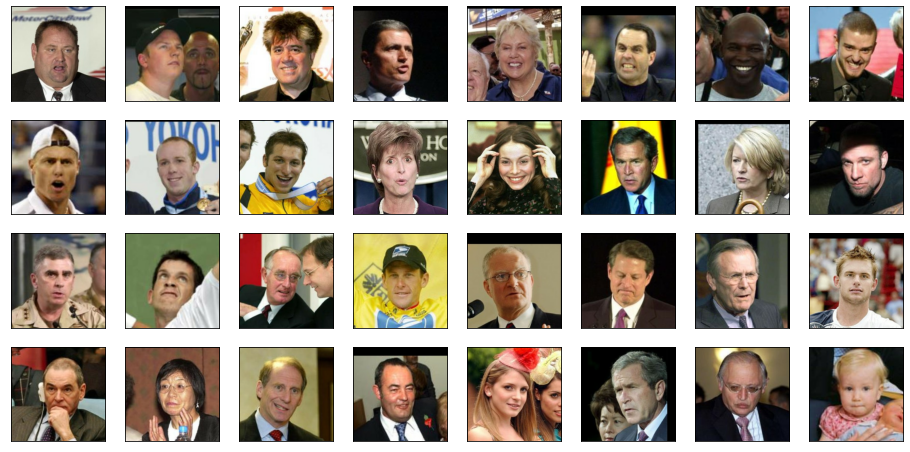

In [ ]:
some_samples = [x[1] for x in iter(train_ds.take(32))]

fig = plt.figure(figsize=(16, 8))
for j in range(len(some_samples)):
    ax = fig.add_subplot(4, 8, j+1)
    ax.imshow(some_samples[j])
    plt.xticks([]), plt.yticks([])
plt.show()

## Deep Convolutional GAN (DCGAN)

## Создание Генератора и Дискриминатора

In [ ]:
generator = tf.keras.Sequential([
    tf.keras.layers.Dense(128*16*16, activation='relu'),
    tf.keras.layers.Reshape((16, 16, 128)),
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(128, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),    
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='valid'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),
    tf.keras.layers.UpSampling2D((2, 2)),    
    tf.keras.layers.Conv2D(64, (3, 3), padding='valid'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.ReLU(),            
    tf.keras.layers.Conv2D(3, (3, 3), padding='same', activation='tanh'),
])

discriminator = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), strides=(2, 2), padding='same'),
    tf.keras.layers.LeakyReLU(0.2),
    tf.keras.layers.Dropout(0.25),    
    tf.keras.layers.Conv2D(64, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.ZeroPadding2D(padding=((0, 1), (0, 1))),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(128, kernel_size=3, strides=(2, 2), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Conv2D(256, kernel_size=3, strides=(1, 1), padding='same'),
    tf.keras.layers.BatchNormalization(momentum=0.8),
    tf.keras.layers.LeakyReLU(alpha=0.2),
    tf.keras.layers.Dropout(0.25),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1),
])

## Подготовка пайплайна данных и оптимизатора

In [ ]:
INPUT_DIM = 256
NUM_EPOCHS = 15
BATCH_SIZE = 32
HALF_BATCH_SIZE = int(BATCH_SIZE / 2)
LEARNING_RATE = 0.0002

def prepare(label, img):
    img = (tf.cast(img, tf.float32) - 127.5) / 127.5 
    return img


train_ds = train_ds.shuffle(buffer_size=1000)
train_ds = train_ds.map(prepare)
train_ds = train_ds.repeat(NUM_EPOCHS)
train_ds = train_ds.batch(HALF_BATCH_SIZE, drop_remainder=True)

optimizer = tf.keras.optimizers.Adam(LEARNING_RATE)
sigmoid_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

## Обучение GAN

[Step  0] D Loss: 0.6876; G Loss: 0.2620


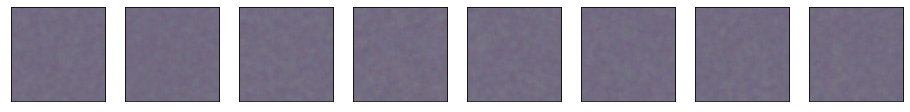

[Step 100] D Loss: 0.1554; G Loss: 1.0945


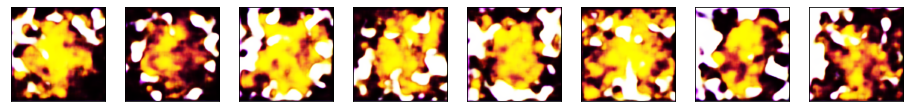

[Step 200] D Loss: 0.2159; G Loss: 2.8883


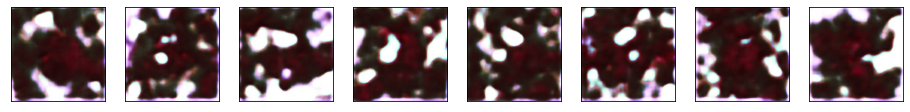

[Step 300] D Loss: 0.2650; G Loss: 1.9404


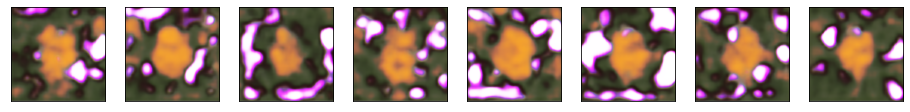

[Step 400] D Loss: 0.1491; G Loss: 3.1828


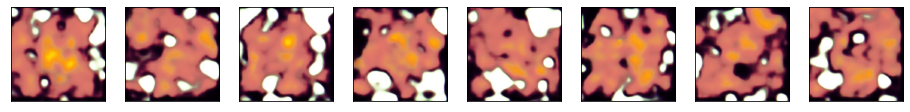

[Step 500] D Loss: 0.0951; G Loss: 3.7200


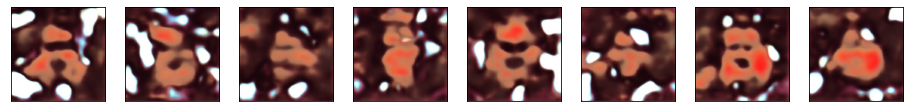

[Step 600] D Loss: 0.8763; G Loss: 4.9153


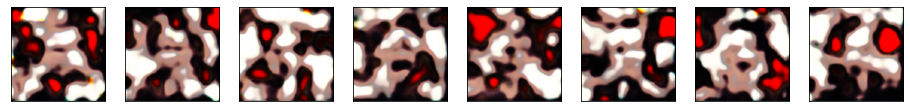

[Step 700] D Loss: 0.9750; G Loss: 0.5305


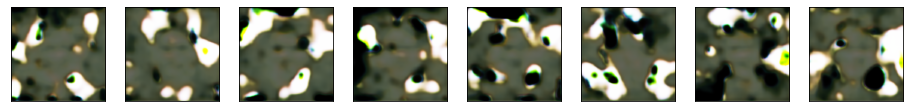

[Step 800] D Loss: 0.2796; G Loss: 1.7577


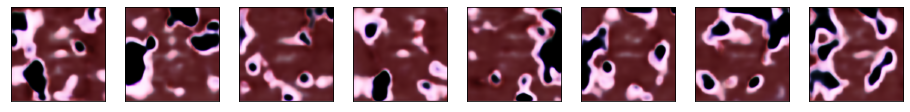

[Step 900] D Loss: 0.8741; G Loss: 3.9578


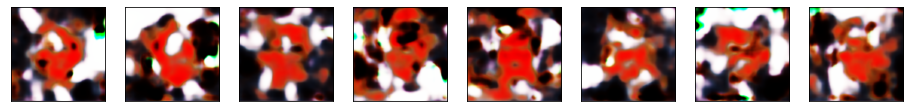

[Step 1000] D Loss: 0.1117; G Loss: 3.0304


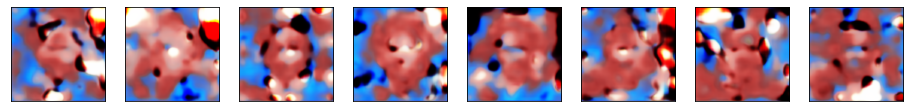

[Step 1100] D Loss: 0.1060; G Loss: 2.9831


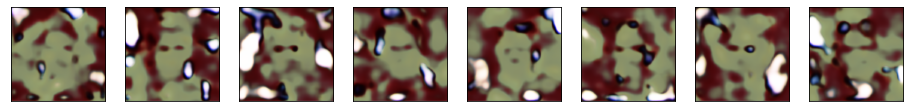

[Step 1200] D Loss: 0.3859; G Loss: 1.8379


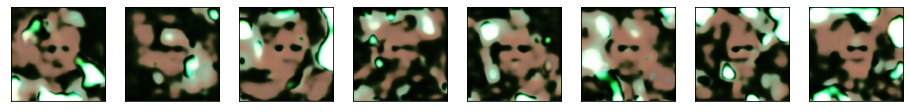

[Step 1300] D Loss: 0.0615; G Loss: 3.4818


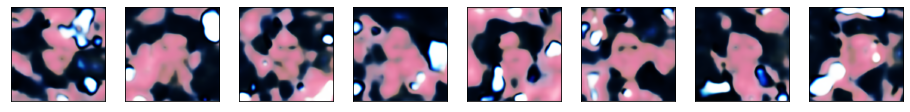

[Step 1400] D Loss: 0.1566; G Loss: 3.3674


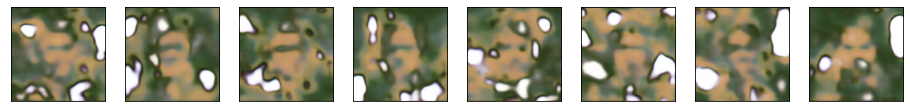

[Step 1500] D Loss: 0.8248; G Loss: 1.0184


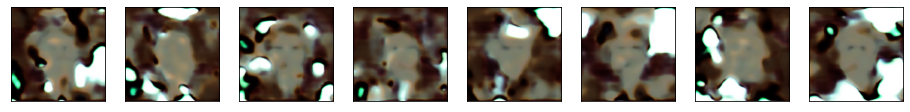

[Step 1600] D Loss: 0.5654; G Loss: 2.1616


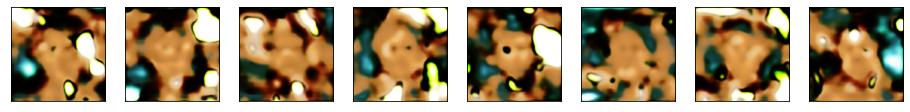

[Step 1700] D Loss: 0.6177; G Loss: 1.8257


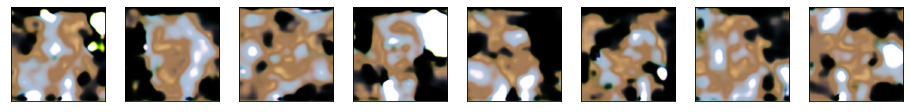

[Step 1800] D Loss: 0.3870; G Loss: 2.4821


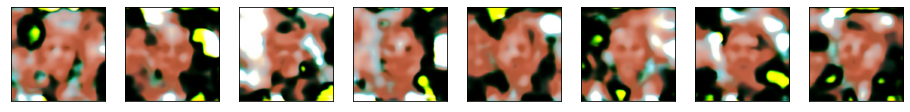

[Step 1900] D Loss: 0.2584; G Loss: 4.2309


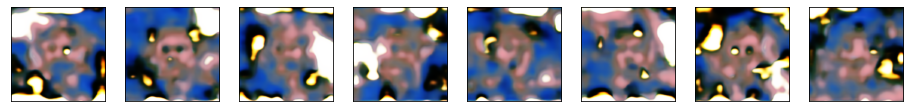

[Step 2000] D Loss: 0.0693; G Loss: 3.6412


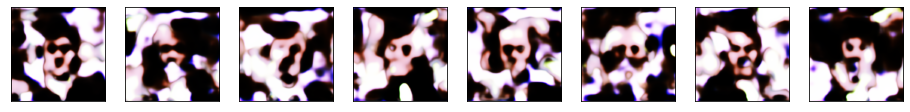

[Step 2100] D Loss: 0.0692; G Loss: 3.3673


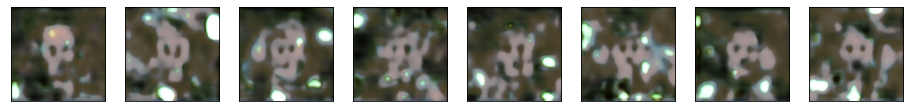

[Step 2200] D Loss: 0.3412; G Loss: 1.8850


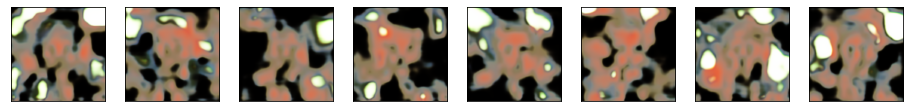

[Step 2300] D Loss: 0.4311; G Loss: 2.1480


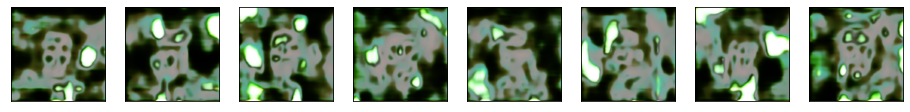

[Step 2400] D Loss: 0.0648; G Loss: 2.1821


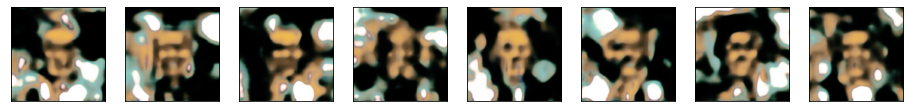

[Step 2500] D Loss: 0.5743; G Loss: 2.7444


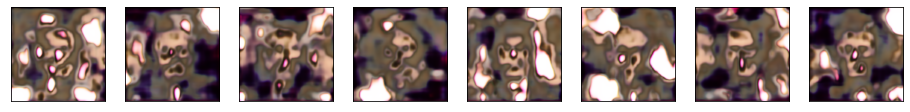

[Step 2600] D Loss: 0.2275; G Loss: 2.4075


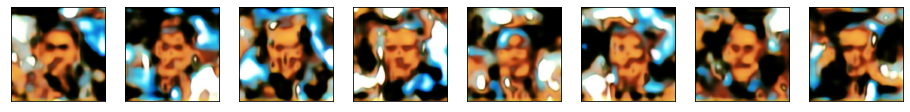

[Step 2700] D Loss: 0.0744; G Loss: 1.6775


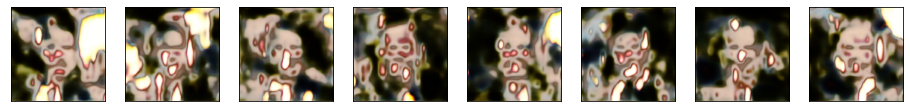

[Step 2800] D Loss: 0.3543; G Loss: 1.7413


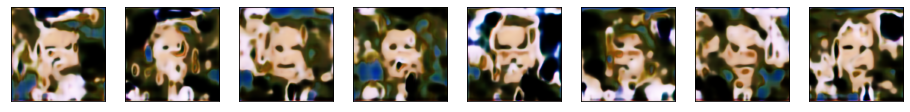

[Step 2900] D Loss: 0.2084; G Loss: 4.2528


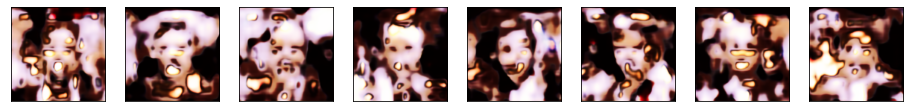

[Step 3000] D Loss: 0.0083; G Loss: 5.6624


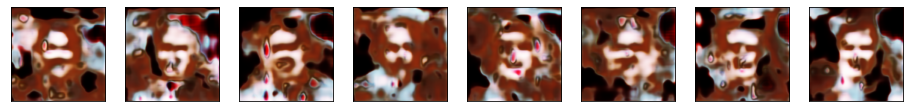

[Step 3100] D Loss: 0.2433; G Loss: 3.8725


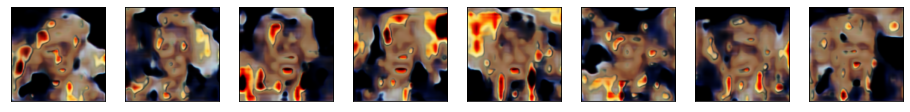

[Step 3200] D Loss: 0.3272; G Loss: 2.9874


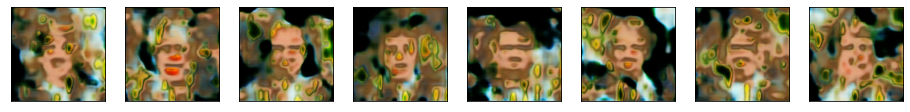

[Step 3300] D Loss: 0.2189; G Loss: 2.7391


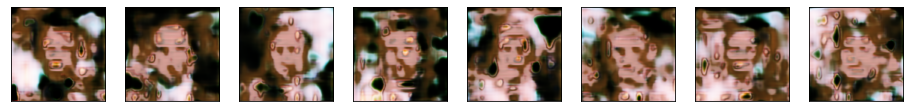

[Step 3400] D Loss: 0.0621; G Loss: 3.5531


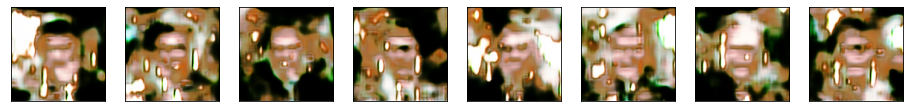

[Step 3500] D Loss: 0.0856; G Loss: 3.9318


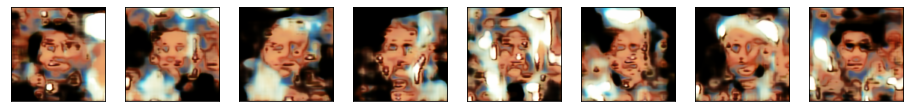

[Step 3600] D Loss: 0.4196; G Loss: 3.1463


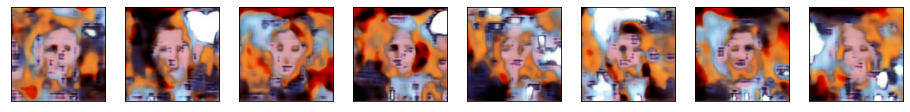

[Step 3700] D Loss: 0.9334; G Loss: 2.8527


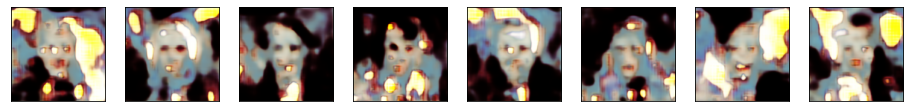

[Step 3800] D Loss: 0.2176; G Loss: 2.8545


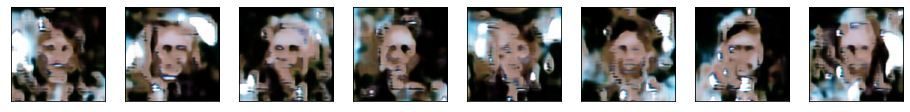

[Step 3900] D Loss: 0.1183; G Loss: 3.3042


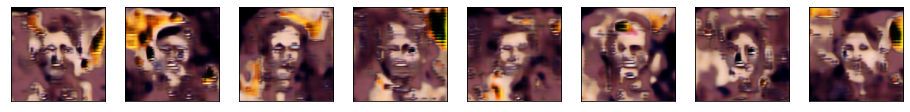

[Step 4000] D Loss: 0.2410; G Loss: 1.9760


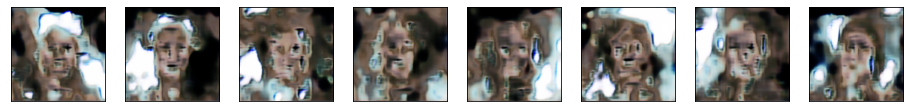

[Step 4100] D Loss: 0.1254; G Loss: 4.2096


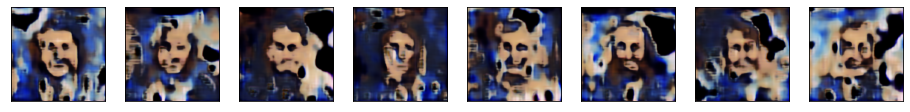

[Step 4200] D Loss: 0.5558; G Loss: 2.5694


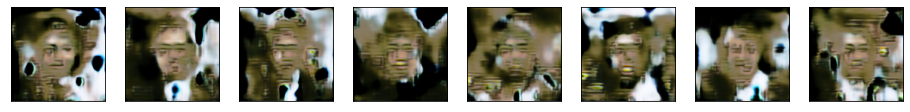

[Step 4300] D Loss: 0.1589; G Loss: 2.2796


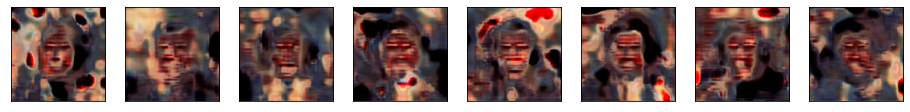

[Step 4400] D Loss: 0.4147; G Loss: 2.1844


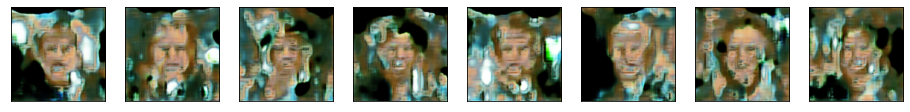

[Step 4500] D Loss: 0.5070; G Loss: 3.3478


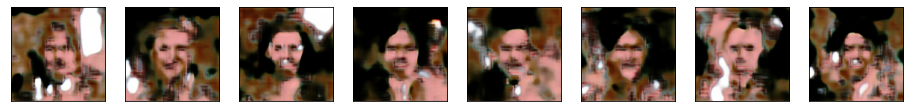

[Step 4600] D Loss: 0.1224; G Loss: 1.8611


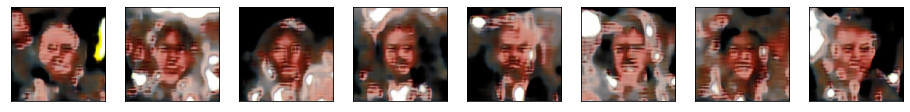

[Step 4700] D Loss: 0.0058; G Loss: 3.8143


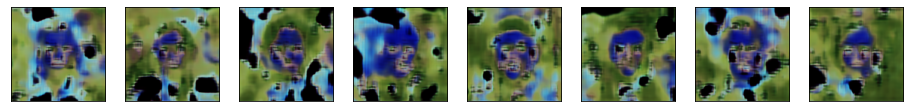

[Step 4800] D Loss: 0.1429; G Loss: 3.1423


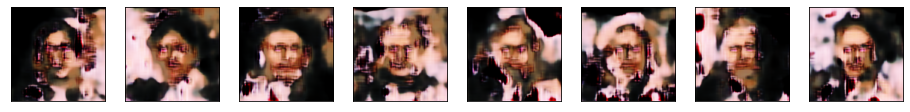

[Step 4900] D Loss: 0.1196; G Loss: 5.5066


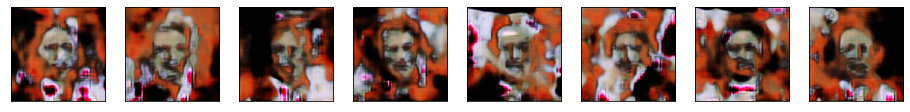

[Step 5000] D Loss: 0.4592; G Loss: 2.4068


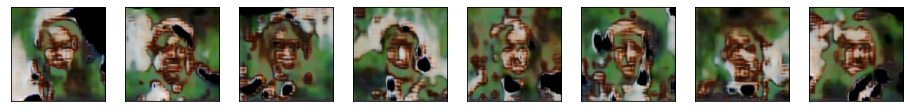

[Step 5100] D Loss: 0.4087; G Loss: 3.4742


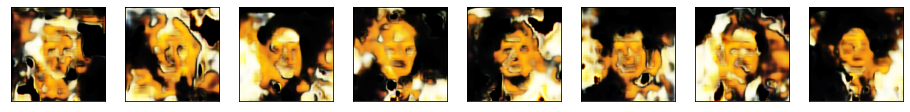

[Step 5200] D Loss: 0.2993; G Loss: 3.2829


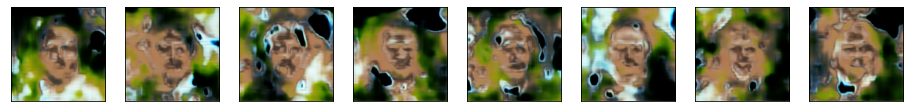

[Step 5300] D Loss: 0.3164; G Loss: 3.2672


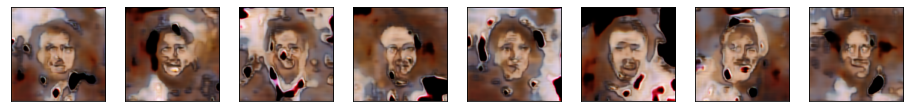

[Step 5400] D Loss: 0.2353; G Loss: 2.9216


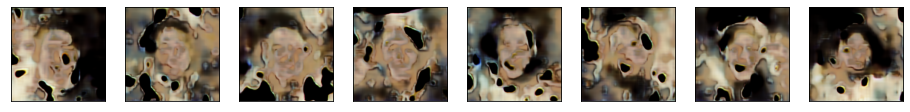

[Step 5500] D Loss: 0.3005; G Loss: 1.5434


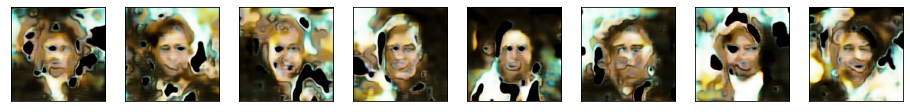

[Step 5600] D Loss: 0.0220; G Loss: 4.8339


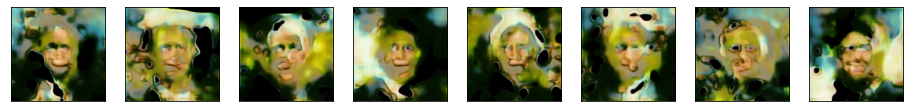

[Step 5700] D Loss: 0.1397; G Loss: 2.0759


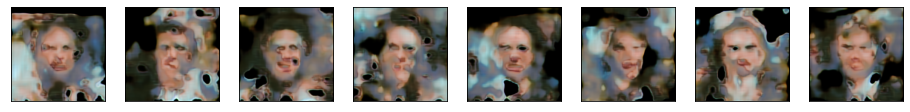

[Step 5800] D Loss: 0.1559; G Loss: 1.7708


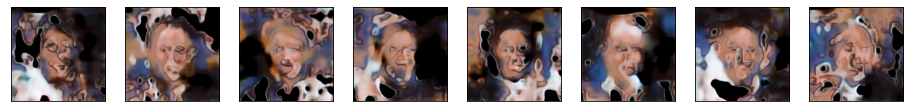

[Step 5900] D Loss: 0.1648; G Loss: 3.4256


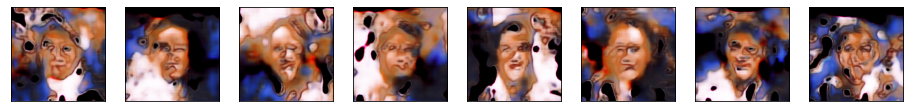

[Step 6000] D Loss: 0.3047; G Loss: 1.7839


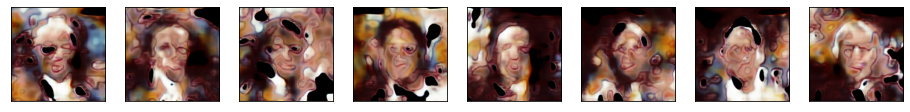

[Step 6100] D Loss: 0.1668; G Loss: 2.6139


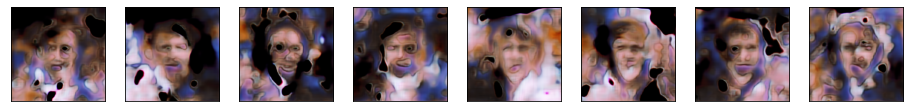

[Step 6200] D Loss: 0.6935; G Loss: 2.9692


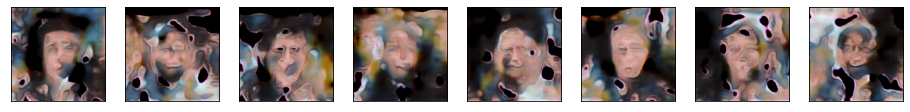

[Step 6300] D Loss: 0.6356; G Loss: 0.8364


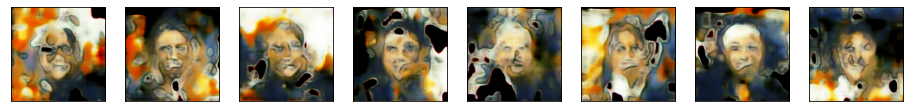

[Step 6400] D Loss: 0.1092; G Loss: 3.5321


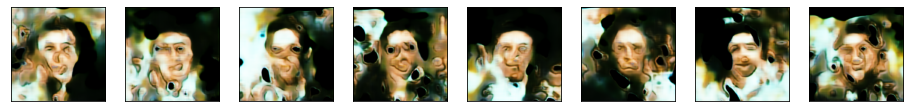

[Step 6500] D Loss: 0.4313; G Loss: 3.0037


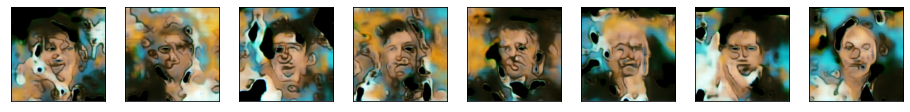

[Step 6600] D Loss: 0.2576; G Loss: 3.1781


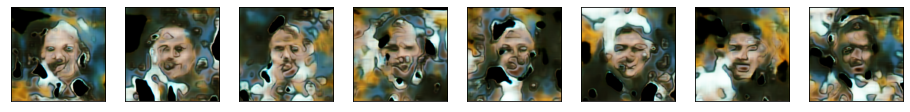

[Step 6700] D Loss: 0.5162; G Loss: 2.3332


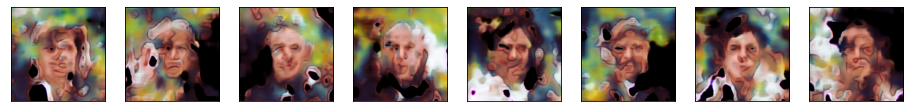

[Step 6800] D Loss: 0.2657; G Loss: 2.1541


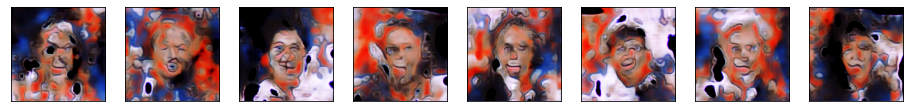

[Step 6900] D Loss: 0.3645; G Loss: 2.3279


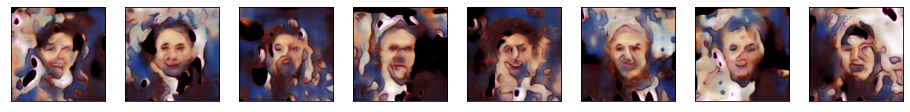

[Step 7000] D Loss: 0.1734; G Loss: 2.5829


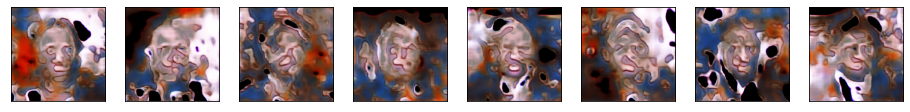

[Step 7100] D Loss: 0.0843; G Loss: 3.2299


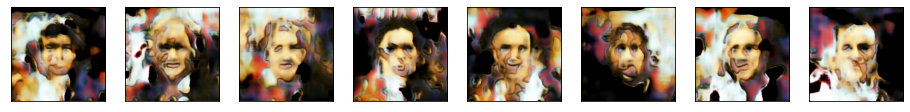

[Step 7200] D Loss: 0.6487; G Loss: 1.7964


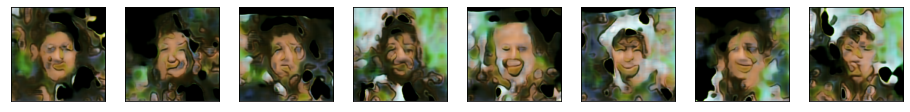

[Step 7300] D Loss: 0.0987; G Loss: 3.0205


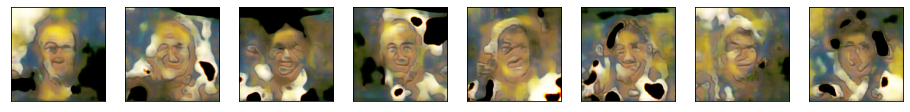

[Step 7400] D Loss: 0.1543; G Loss: 3.0011


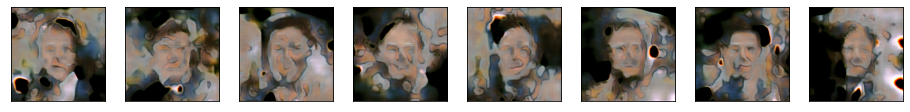

[Step 7500] D Loss: 0.4856; G Loss: 2.8501


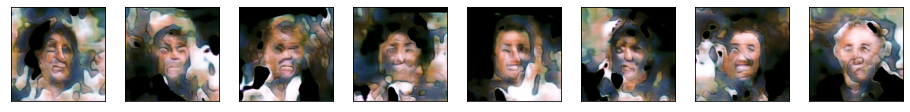

[Step 7600] D Loss: 0.1811; G Loss: 1.7548


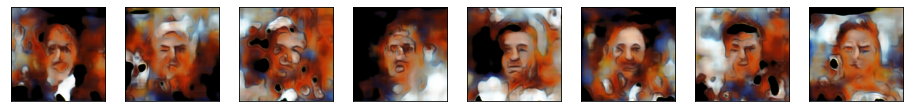

[Step 7700] D Loss: 0.2309; G Loss: 3.2272


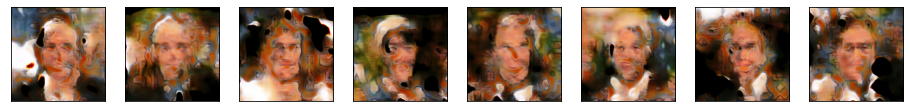

[Step 7800] D Loss: 0.2914; G Loss: 4.3209


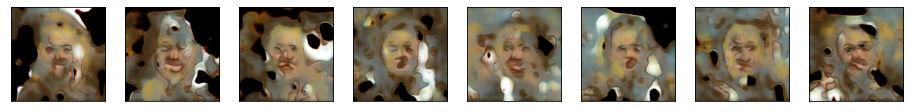

[Step 7900] D Loss: 0.1551; G Loss: 2.2988


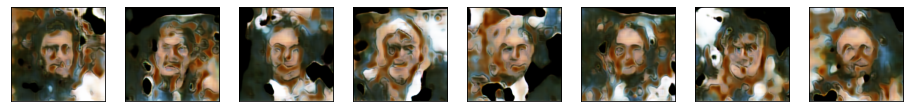

[Step 8000] D Loss: 0.5229; G Loss: 3.0866


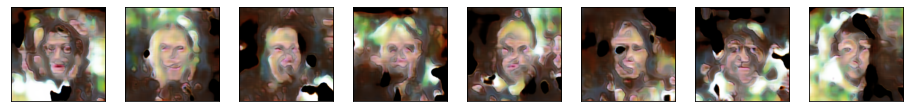

[Step 8100] D Loss: 0.0962; G Loss: 4.4074


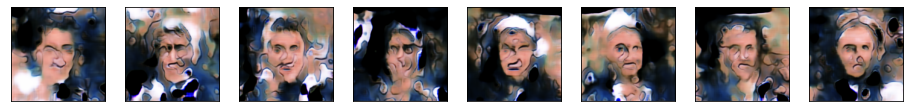

[Step 8200] D Loss: 0.0366; G Loss: 4.3826


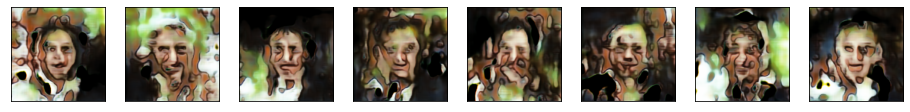

[Step 8300] D Loss: 0.1115; G Loss: 2.1120


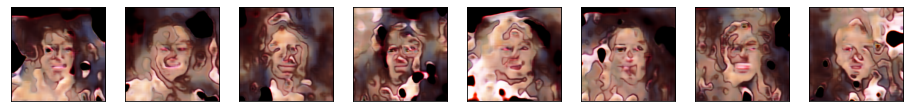

[Step 8400] D Loss: 0.1273; G Loss: 3.6858


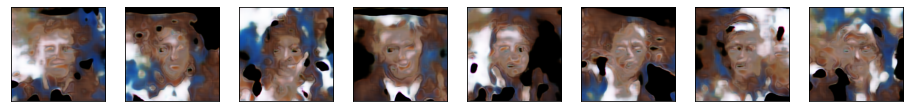

[Step 8500] D Loss: 0.2070; G Loss: 2.9986


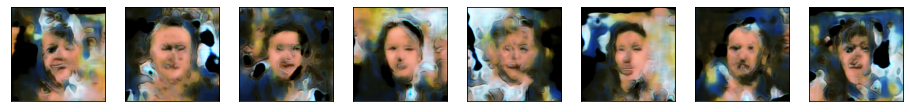

[Step 8600] D Loss: 0.1907; G Loss: 2.8334


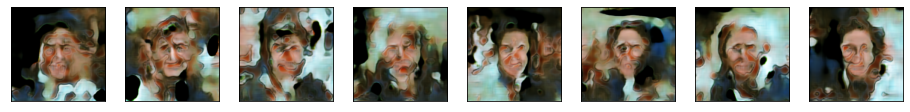

[Step 8700] D Loss: 0.2242; G Loss: 2.9697


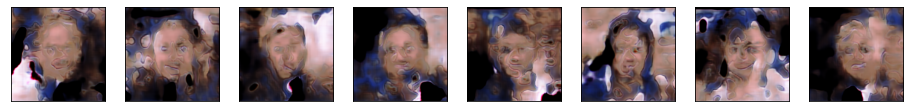

[Step 8800] D Loss: 0.0519; G Loss: 3.0599


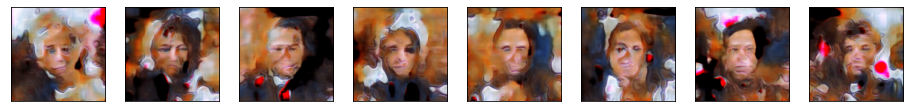

[Step 8900] D Loss: 0.1181; G Loss: 2.3760


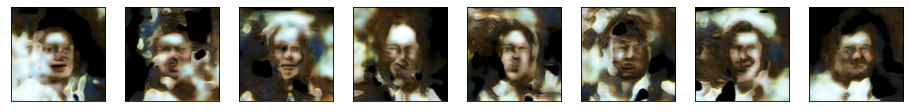

[Step 9000] D Loss: 0.4274; G Loss: 1.5179


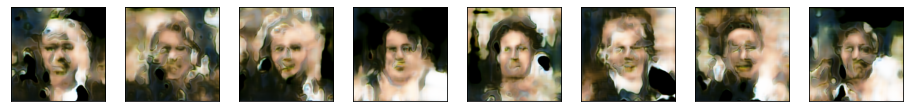

[Step 9100] D Loss: 0.0248; G Loss: 5.6658


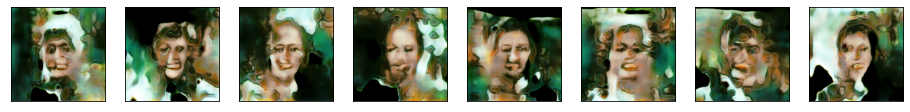

[Step 9200] D Loss: 0.1369; G Loss: 3.5796


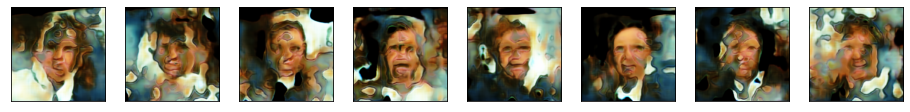

[Step 9300] D Loss: 0.3098; G Loss: 3.8058


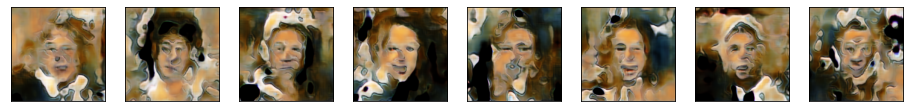

[Step 9400] D Loss: 0.4035; G Loss: 3.6160


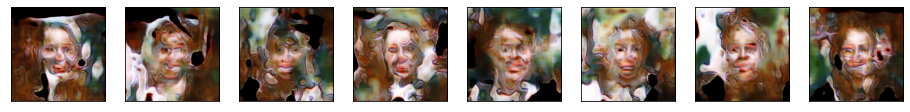

[Step 9500] D Loss: 0.1920; G Loss: 2.7611


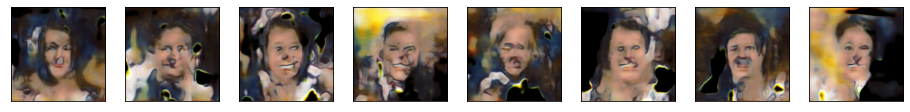

[Step 9600] D Loss: 0.2940; G Loss: 3.0423


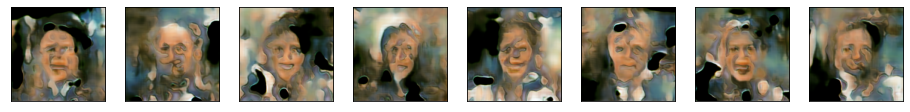

[Step 9700] D Loss: 0.3105; G Loss: 4.3632


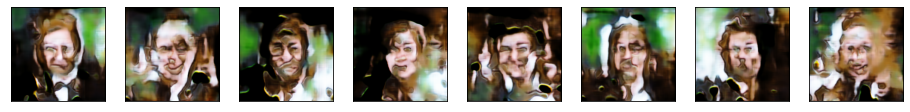

[Step 9800] D Loss: 0.3218; G Loss: 2.5199


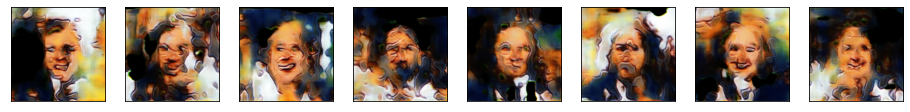

[Step 9900] D Loss: 0.0258; G Loss: 4.5246


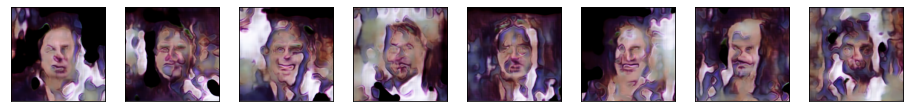

[Step 10000] D Loss: 0.0357; G Loss: 5.0205


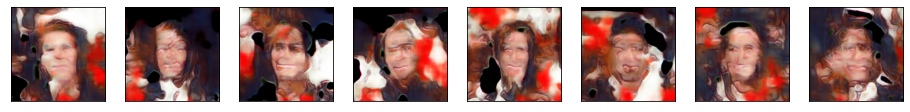

[Step 10100] D Loss: 0.1073; G Loss: 3.0398


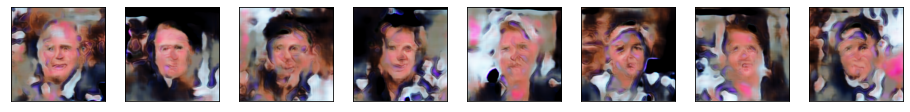

[Step 10200] D Loss: 0.1428; G Loss: 4.3666


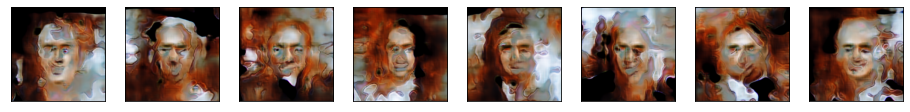

[Step 10300] D Loss: 0.4869; G Loss: 1.6419


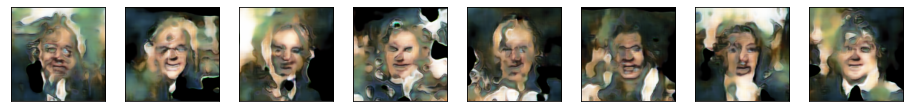

[Step 10400] D Loss: 0.0865; G Loss: 2.9797


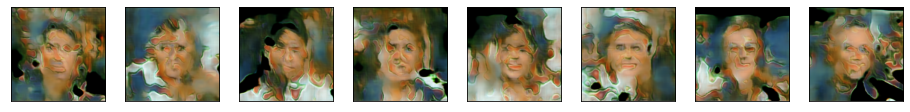

[Step 10500] D Loss: 0.0532; G Loss: 3.7065


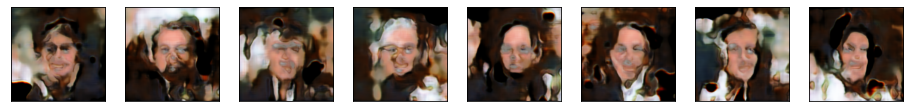

[Step 10600] D Loss: 0.0583; G Loss: 4.9532


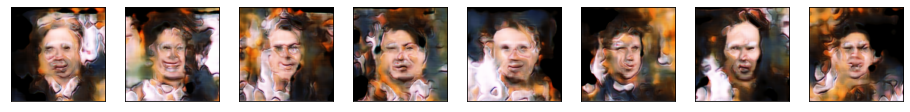

[Step 10700] D Loss: 0.2283; G Loss: 3.9601


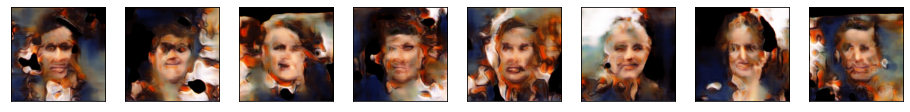

[Step 10800] D Loss: 0.0595; G Loss: 3.9486


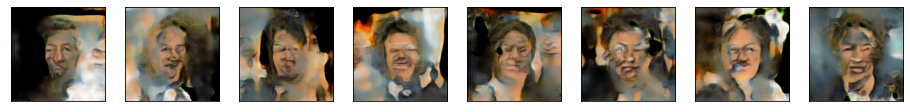

[Step 10900] D Loss: 0.3857; G Loss: 2.9375


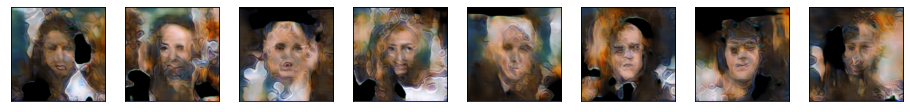

[Step 11000] D Loss: 0.1629; G Loss: 3.1305


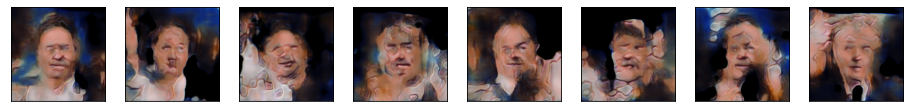

[Step 11100] D Loss: 0.2063; G Loss: 5.3312


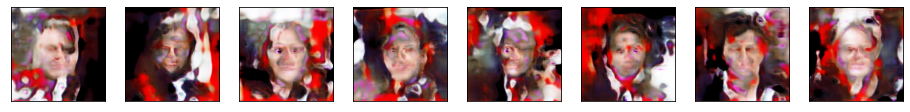

[Step 11200] D Loss: 0.0573; G Loss: 5.4884


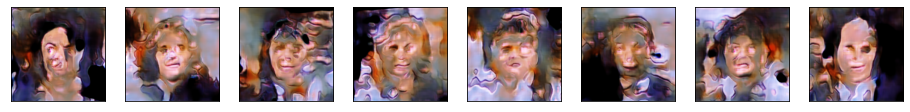

[Step 11300] D Loss: 0.3105; G Loss: 2.8870


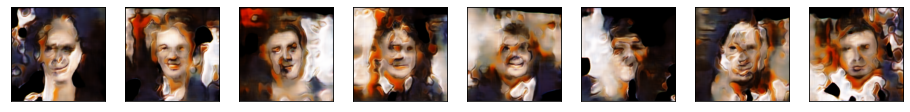

[Step 11400] D Loss: 0.0828; G Loss: 2.9750


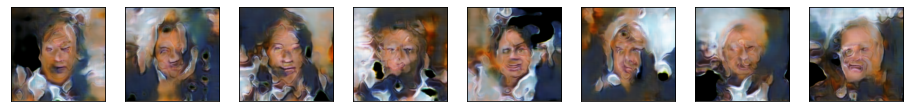

[Step 11500] D Loss: 0.1328; G Loss: 4.3913


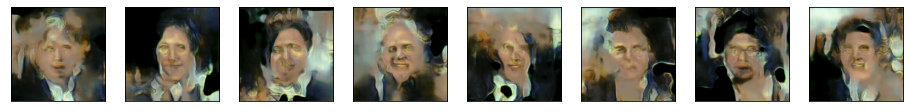

[Step 11600] D Loss: 0.1677; G Loss: 4.1043


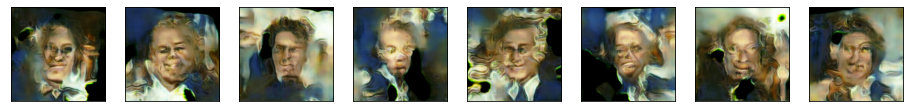

[Step 11700] D Loss: 0.0694; G Loss: 3.2545


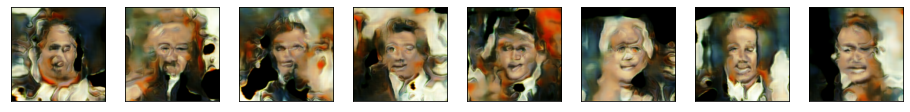

[Step 11800] D Loss: 0.2328; G Loss: 2.2969


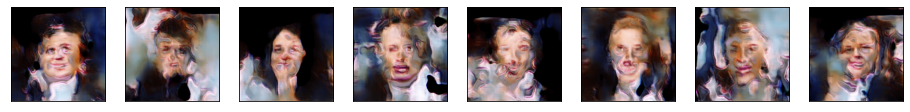

[Step 11900] D Loss: 0.0771; G Loss: 5.3017


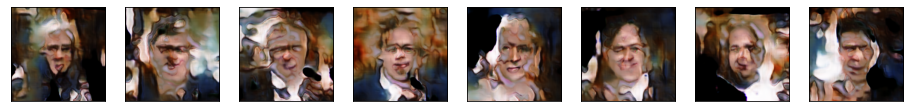

[Step 12000] D Loss: 0.0797; G Loss: 3.7800


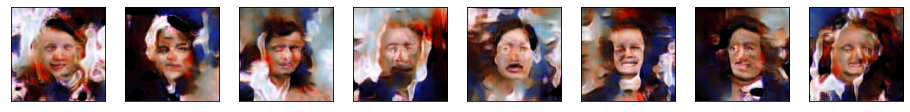

[Step 12100] D Loss: 0.2471; G Loss: 3.7639


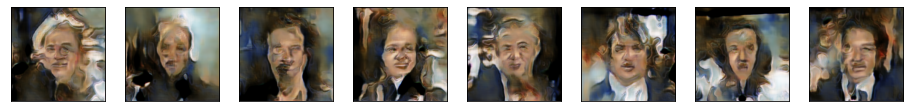

[Step 12200] D Loss: 0.2447; G Loss: 4.9585


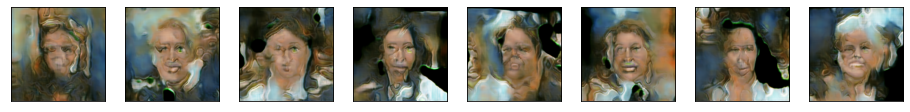

[Step 12300] D Loss: 0.0845; G Loss: 3.7214


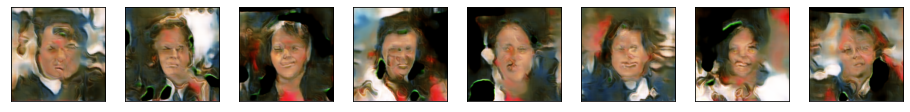

[Step 12400] D Loss: 0.0825; G Loss: 3.4915


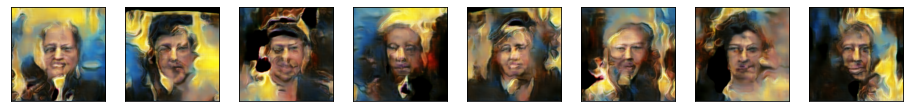

In [ ]:
for step, true_images in enumerate(train_ds):
    
    # Train Discriminator
    
    noise = np.random.normal(0, 1, (HALF_BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    syntetic_images = generator.predict(noise)
    x_combined = np.concatenate((
        true_images, 
        syntetic_images))
    y_combined = np.concatenate((
        np.ones((HALF_BATCH_SIZE, 1), np.float32), 
        np.zeros((HALF_BATCH_SIZE, 1), np.float32)))
    
    with tf.GradientTape() as tape:
        logits = discriminator(x_combined)
        d_loss_value = sigmoid_cross_entropy(y_combined, logits)
    grads = tape.gradient(d_loss_value, discriminator.trainable_variables)
    optimizer.apply_gradients(zip(grads, discriminator.trainable_variables))
    
    # Train Generator
    
    noise = np.random.normal(0, 1, (BATCH_SIZE, INPUT_DIM)).astype(np.float32)
    y_mislabled = np.ones((BATCH_SIZE, 1), np.float32)
    
    with tf.GradientTape() as tape:
        logits = discriminator(generator(noise, training=True))
        g_loss_value = sigmoid_cross_entropy(y_mislabled, logits)
    grads = tape.gradient(g_loss_value, generator.trainable_variables)
    optimizer.apply_gradients(zip(grads, generator.trainable_variables))
    
    # Check intermediate results
    
    if step % 100 == 0:
        print('[Step %2d] D Loss: %.4f; G Loss: %.4f' % (
            step, d_loss_value.numpy(), g_loss_value.numpy()))
        noise = np.random.normal(0, 1, (8, INPUT_DIM)).astype(np.float32)
        syntetic_images = generator.predict(noise)
        
        fig = plt.figure(figsize=(16, 8))
        for j in range(len(syntetic_images)):
            ax = fig.add_subplot(4, 8, j+1)
            ax.imshow((syntetic_images[j]+1)/2)
            plt.xticks([]), plt.yticks([])
        plt.show()


## Тестирование свёрточного генератора

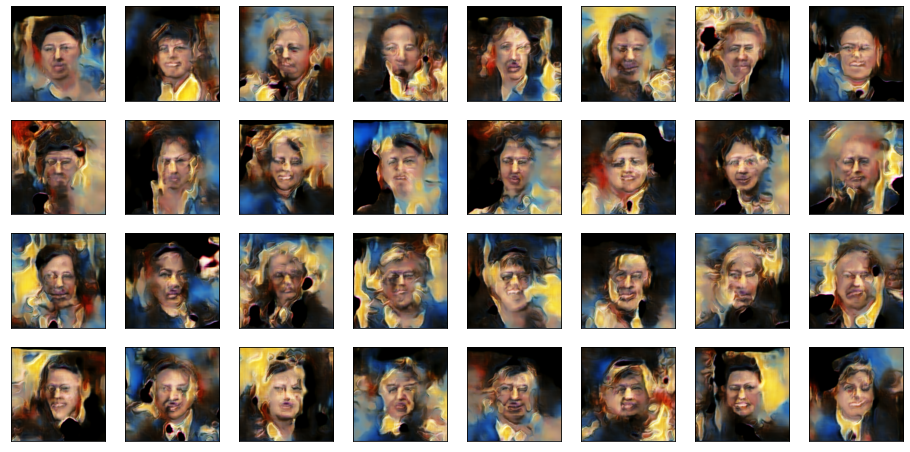

In [ ]:
noise = np.random.normal(0, 1, (32, INPUT_DIM)).astype(np.float32)
syntetic_images = generator.predict(noise)

fig = plt.figure(figsize=(16, 8))
for j in range(len(syntetic_images)):
    ax = fig.add_subplot(4, 8, j+1)
    ax.imshow((syntetic_images[j]+1)/2)
    plt.xticks([]), plt.yticks([])
plt.show()

## Интерполяция в латентном пространстве

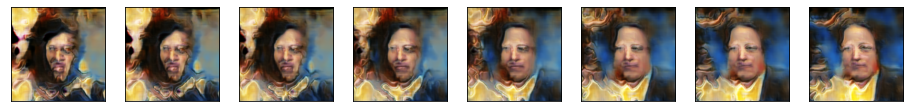

In [ ]:
noise_1 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise_2 = np.random.normal(0, 1, (INPUT_DIM)).astype(np.float32)
noise = np.linspace(noise_1, noise_2, 8)
syntetic_images = generator.predict(noise)
fig = plt.figure(figsize=(16, 8))
for j in range(len(syntetic_images)):
    ax = fig.add_subplot(4, 8, j+1)
    ax.imshow((syntetic_images[j]+1)/2)
    plt.xticks([]), plt.yticks([])
plt.show()

Вывод: Генерация получилась посредственной, возможно стоит усложнить генератор и дискриминатор, а так же увеличеть число эпох на обучение